In [214]:
import os
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import ast
import zarr
from src.utilities.plot_functions import format_2d_plotly, format_3d_plotly

## Load tracking and curation data

In [215]:
root = "E:\\Nick\\Cole Trapnell's Lab Dropbox\\Nick Lammers\\Nick\\killi_tracker\\"

os.environ["QT_API"] = "pyqt5"
os.environ["PYQTGRAPH_QT_LIB"] = "PyQt5"
os.environ["QT_API"] = "pyqt5"

project_name = "20250311_LCP1-NLSMSC"
stitch_suffix = ""
fig_path = os.path.join(root, "figures", project_name, "lcp_lineage")
os.makedirs(fig_path, exist_ok=True)
# load image dataset
zpath = os.path.join(root, "built_data", "zarr_image_files", project_name + "_fused.zarr")
fused_image_zarr = zarr.open(zpath, mode="r")

# load full tracking dataset
print("Loading tracking data for project:", project_name)
nls_track_path = os.path.join(root, "tracking", project_name, "tracking_20250328_redux", "well0000", "track_0000_2339_cb", "")
nls_tracks_df = pd.read_csv(os.path.join(nls_track_path, "tracks" + stitch_suffix + "_fluo.csv"))
nucleus_class_df = pd.read_csv(os.path.join(nls_track_path, "track_class_df_full.csv"))

# add class info to tracks
nls_tracks_df = nls_tracks_df.merge(nucleus_class_df.loc[:, ["track_id", "t", "track_class", "frame_class"]], on=["track_id", "t"], how="left")
nls_tracks_df.loc[:, "z_scaled"] = nls_tracks_df["z"].copy() * 3

print("Loading lcp tracking data for project:", project_name)
lcp_track_path = os.path.join(root, "built_data", "tracking", project_name, "")
lcp_tracks_df = pd.read_csv(os.path.join(lcp_track_path, "lcp_tracks_df.csv"))

lcp_curation_df = pd.read_csv(os.path.join(lcp_track_path, "20250311_lcp_track_curation.csv"))

Loading tracking data for project: 20250311_LCP1-NLSMSC
Loading lcp tracking data for project: 20250311_LCP1-NLSMSC


## Use curation data to construct continuous lcp tracks

In [216]:
from scipy.spatial import distance_matrix
from tqdm import tqdm

track_id_index = lcp_curation_df["ID"].unique()

lcp_track_list = []

for id in tqdm(track_id_index):

    # get basic parameters
    start_frame = lcp_curation_df[lcp_curation_df["ID"] == id]["first_frame_id"].to_numpy()[0]
    stop_frame = lcp_curation_df[lcp_curation_df["ID"] == id]["last_frame_id"].to_numpy()[0]
    lcp_parent_id = lcp_curation_df[lcp_curation_df["ID"] == id]["lcp_parent"].to_numpy()[0]

    # lcp_last_id = lcp_curation_df[lcp_curation_df["ID"] == id]["final_frame_id"].to_numpy()[0] # confusing notation, but this is the last track ID

    # get lineage
    lineage = np.asarray(ast.literal_eval(lcp_curation_df[lcp_curation_df["ID"] == id]["lcp_lineage"].to_numpy()[0]))

    # link tracklets from late->early. Any time there is ambiguity, take option that requires smallest leap
    lineage_tracks = lcp_tracks_df.loc[np.isin(lcp_tracks_df["track_id"], lineage), :].copy()

    frame_curr = stop_frame
    frame_vec = [stop_frame]
    track_id_vec = [lineage[0]]
    track_pos_vec = [lineage_tracks.loc[(lineage_tracks["t"] == frame_curr) & (lineage_tracks["track_id"]==lineage[0]), ["z", "y", "x"]].to_numpy()[0]]
    track_fluo_vec = [lineage_tracks.loc[(lineage_tracks["t"] == frame_curr) & (lineage_tracks["track_id"]==lineage[0]), "mean_fluo"].to_numpy()[0]]

    for frame in range(stop_frame + 1, start_frame - 1, -1):
        # see what options we have (if any)
        track_id_options = lineage_tracks.loc[lineage_tracks["t"] == frame, "track_id"].to_numpy()
        fluo_options = lineage_tracks.loc[lineage_tracks["t"] == frame, "mean_fluo"].to_numpy()
        track_pos_options = lineage_tracks.loc[lineage_tracks["t"] == frame, ["z", "y", "x"]].to_numpy()
        if len(track_id_options) == 0:
            pass
        elif len(track_id_options) == 1:
            # simple case
            track_id = track_id_options[0]
            track_pos = track_pos_options[0]
            track_fluo = fluo_options[0]

            frame_vec.append(frame)
            track_id_vec.append(track_id)
            track_pos_vec.append(track_pos)
            track_fluo_vec.append(track_fluo)

        elif len(track_id_options) > 1:
            post_pos = track_pos_vec[-1]
            dist_vec = distance_matrix(track_pos_options, post_pos.reshape(1, -1)).flatten()
            best_i = np.argmin(dist_vec)

            track_id = track_id_options[best_i]
            track_pos = track_pos_options[best_i]
            track_fluo = fluo_options[best_i]

            frame_vec.append(frame)
            track_id_vec.append(track_id)
            track_pos_vec.append(track_pos)
            track_fluo_vec.append(track_fluo)

    # conveert to df
    temp_df = pd.DataFrame(frame_vec, columns=["t"])
    temp_df["track_id"] = id
    temp_df["raw_track_id"] = track_id_vec
    temp_df[["z", "y", "x"]] = np.vstack(track_pos_vec)
    temp_df["mean_fluo"] = track_fluo_vec

    lcp_track_list.append(temp_df)

100%|██████████| 10/10 [00:03<00:00,  2.92it/s]


## Get snapshot of image showing mature cells in our dataset

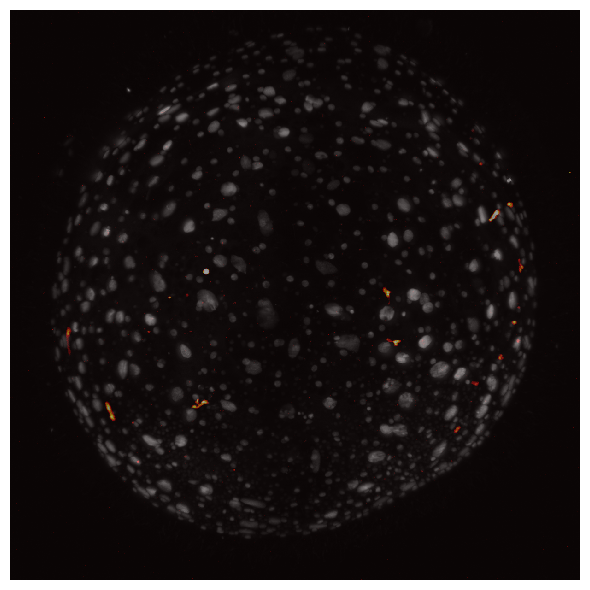

In [217]:
from matplotlib import pyplot as plt

frame = 2326
z_depth = 220

lcp_mip = np.max(np.squeeze(fused_image_zarr[frame, 0]), axis=0)
nls_mip = np.max(np.squeeze(fused_image_zarr[frame, 1]), axis=0)

fig, ax = plt.subplots(figsize=(6,6))
# show the base layer in grayscale
ax.imshow(nls_mip, cmap='gray', interpolation='nearest', vmax=2000, vmin=10)
# overlay the second layer with a color map and alpha blending
ax.imshow(lcp_mip, cmap='hot', alpha=0.5, interpolation='nearest', vmax=200, vmin=115)

ax.axis('off')  # hide axes ticks
plt.tight_layout()

fig.patch.set_facecolor('none')
fig.savefig(os.path.join(fig_path, "lcp_mip.png"),  # or .pdf, .svg, .jpg, etc.
            dpi=300,        # resolution in dots per inch
            bbox_inches='tight')

plt.show()
# plt.imsave, lcp_mip, cmap='hot', alpha=0.5, interpolation='nearest', vmax=150, vmin=115)

In [218]:
from src.utilities.plot_functions import format_3d_plotly, rotate_figure

# combine into a DF
lcp_tracks_manual_df = pd.concat(lcp_track_list, axis=0, ignore_index=True)
lcp_tracks_manual_df["track_id_cat"] = lcp_tracks_manual_df["track_id"].astype("category")
lcp_tracks_manual_df = lcp_tracks_manual_df.sort_values(["track_id", "t"])

lcp_first = lcp_tracks_manual_df.groupby("track_id").first().reset_index()
lcp_last = lcp_tracks_manual_df.groupby("track_id").last().reset_index()

color_palette = px.colors.qualitative.Plotly
track_colors_first = dict(zip(lcp_first["track_id_cat"].cat.categories, color_palette))
track_colors_last = dict(zip(lcp_last["track_id_cat"].cat.categories, color_palette))
track_colors = dict(zip(lcp_tracks_manual_df["track_id_cat"].cat.categories, color_palette))

colors_first = lcp_first['track_id_cat'].map(track_colors_first)
colors_last = lcp_last['track_id_cat'].map(track_colors_last)
colors = lcp_tracks_manual_df['track_id_cat'].map(track_colors_last)
marker_size = 10


fig = go.Figure()

# px.line_3d(lcp_tracks_manual_df, x="x", y="y", z="z", color="track_id_cat")
dims = [800, 800]
x_range = [100, 1200]
y_range = [200, 1000] #fig.layout.scene.yaxis.range
z_range = [100, 700] #fig.layout.scene.zaxis.range

fig.layout.scene.zaxis.range = z_range
fig.layout.scene.xaxis.range = x_range
fig.layout.scene.yaxis.range = y_range


fig = format_3d_plotly(fig, axis_labels=["X (um)", "Y (um)", "Z (um)"], font_size=18, marker_size=marker_size, marker_lines=False, show_gridlines=True, dims=dims)

fig.add_trace(go.Scatter3d(x=lcp_last["x"], y=lcp_last["y"], z=lcp_last["z"], mode="markers", marker=dict(
                    size=marker_size, color="white", opacity=1), name="start"))

fig.add_trace(go.Scatter3d(x=lcp_last["x"], y=lcp_last["y"], z=lcp_last["z"], mode="markers", marker=dict(
                    size=marker_size*0.7, color=colors_last, opacity=1), name="start"))
# fig.add_trace(go.Scatter3d(x=lcp_first["x"], y=lcp_first["y"], z=lcp_first["z"], mode="markers", marker=dict(size=marker_size*0.2, color="white", opacity=1)))

fig.update_traces(line=dict(width=4))

fig.update_layout(
    scene=dict(
        xaxis=dict(showticklabels=False),
        yaxis=dict(showticklabels=False),
        zaxis=dict(showticklabels=False),
    )
)

fig.update_layout(showlegend=False)

fig = rotate_figure(fig, z_rotation=210, zoom_factor=1.0, elev_rotation=-25)

fig.write_image(os.path.join(fig_path, "lcp_tracks_3d_ends.png"), width=dims[1], height=dims[0])

for track in np.unique(lcp_tracks_manual_df["track_id"]):
    track_df = lcp_tracks_manual_df[lcp_tracks_manual_df["track_id"] == track]
    fig.add_trace(go.Scatter3d(x=track_df["x"], y=track_df["y"], z=track_df["z"], mode="lines", line=dict(width=3, color=colors_first[track-1])))
# fig.add_trace(go.Scatter3d(x=lcp_tracks_manual_df["x"], y=lcp_tracks_manual_df["y"], z=lcp_tracks_manual_df["z"], mode="lines", line=dict(width=2, color=colors), name="tracks"))
fig.write_image(os.path.join(fig_path, "lcp_tracks_3d_tracks.png"), width=dims[1], height=dims[0])
# update legend title
# fig.update_layout(legend_title_text="Cell ID")
fig.add_trace(go.Scatter3d(x=lcp_first["x"], y=lcp_first["y"], z=lcp_first["z"], mode="markers", marker=dict(size=marker_size, color=colors_first, opacity=1)))
fig.add_trace(go.Scatter3d(x=lcp_first["x"], y=lcp_first["y"], z=lcp_first["z"], mode="markers", marker=dict(size=marker_size*0.5, color="white", opacity=1)))
# hide legend


fig.show()

fig.write_image(os.path.join(fig_path, "lcp_tracks_3d_starts.png"), width=dims[1], height=dims[0])

## Fluo over time for each track

In [219]:
def compute_diffs(df, max_gap):
    df = df.sort_values('t')
    # Compute differences
    df[['dt', 'dx', 'dy', 'dz']] = df.groupby('track_id')[['stage', 'x', 'y', 'z']].diff().bfill()

    # Invalidate diffs where time gap exceeds max_gap
    # large_gap = df['dt'] > max_gap
    # df.loc[large_gap, ['dx', 'dy', 'dz']] = np.nan
    return df

In [220]:


# Loop through each track for simple linear interpolation
def interpolate_linear_per_track(group):
    # Sort by frame
    group_sorted = group.sort_values('t')

    # Define complete frame range
    full_frames = np.arange(group_sorted['t'].min(), group_sorted['t'].max() + 1)

    # Reindex to full frame list
    interp_df = pd.DataFrame({'t': full_frames}).set_index('t')
    data_to_interp = group_sorted.set_index('t')[['mean_fluo', 'speed', 'x', 'y', 'z']]
    combined = interp_df.join(data_to_interp)

    # Perform simple linear interpolation
    combined_interpolated = combined.interpolate(method='linear')

    # Restore track_id and reset index
    combined_interpolated['track_id'] = group_sorted['track_id'].iloc[0]
    combined_interpolated = combined_interpolated.reset_index()

    return combined_interpolated


# Concatenate all tracks
# final_interp_df = pd.concat(interpolated_dfs, ignore_index=True)

In [221]:
# calculate speed
lcp_tracks_manual_df["stage"] = 26 + lcp_tracks_manual_df["t"] * 1.5 / 60
# lcp_tracks_manual_df = compute_diffs(lcp_tracks_manual_df, max_gap=5/60)
lcp_tracks_manual_df = lcp_tracks_manual_df.sort_values(['track_id', 't'])
lcp_tracks_manual_df[['dt', 'dx', 'dy', 'dz']] = lcp_tracks_manual_df.groupby('track_id')[['stage', 'x', 'y', 'z']].diff().bfill()
lcp_tracks_manual_df["speed"] = np.divide(np.sqrt(lcp_tracks_manual_df["dx"]**2 + lcp_tracks_manual_df["dy"]**2 + lcp_tracks_manual_df["dz"]**2), lcp_tracks_manual_df["dt"]) / 60

# interpolate
# Final list to accumulate interpolated DataFrames
interpolated_dfs = []
for track_id, group in lcp_tracks_manual_df.groupby('track_id'):
    interpolated_dfs.append(interpolate_linear_per_track(group))

lcp_df_interp = pd.concat(interpolated_dfs, ignore_index=True)

In [222]:
# apply gaussian smoothing
window_size = 50      # must be an odd integer ≥ 3

lcp_df_interp[["fluo_trend", "speed_trend"]] = lcp_df_interp.groupby("track_id")[['mean_fluo', 'speed']] \
      .rolling(window=window_size, center=True, min_periods=1) \
      .mean().reset_index(drop=True)

# finally, join on flag to indicate which rows are original
lcp_df = lcp_df_interp.merge(lcp_tracks_manual_df.loc[:, ["track_id", "t"]], on=["track_id", "t"], how="left", indicator=True)
lcp_df["is_original"] = lcp_df["_merge"] == "both"
lcp_df = lcp_df.drop(columns=["_merge"])
lcp_df["stage"] = 26 + lcp_df["t"] * 1.5 / 60

In [223]:
# calculate
fig = px.line(lcp_df, x="stage", y="fluo_trend", color="track_id")

fig = format_2d_plotly(fig, axis_labels=["stage (hpf)", "lcp intensity (au)"], font_size=18, marker_size=5, marker_lines=True, show_gridlines=True)
fig.update_traces(line=dict(width=4))
fig.show()

fig.write_image(os.path.join(fig_path, "lcp_tracks_fluo.png"), width=800, height=600)

## What about fluo vs velocity?

In [224]:
# calculate
fig = px.line(lcp_df, x="stage", y="speed_trend", color="track_id")

fig = format_2d_plotly(fig, axis_labels=["stage (hpf)", "cell speed (um/min)"], font_size=18, marker_size=5, marker_lines=True, show_gridlines=True)
fig.update_traces(line=dict(width=4))

fig.update_layout(xaxis_range=[70, 84],
                  yaxis_range=[0, 14])
fig.show()

fig.write_image(os.path.join(fig_path, "lcp_tracks_speed.png"), width=800, height=600)

In [225]:
lcp_df["track_id_cat"] = lcp_df["track_id"].astype("category")
fig = px.scatter(lcp_df, x="stage", y="speed", color="track_id_cat", trendline="ols", opacity=0.2)

fig = format_2d_plotly(fig, axis_labels=["stage (hpf)", "cell speed (um/min)"], font_size=18, marker_size=5, marker_lines=False, show_gridlines=True)
fig.update_traces(line=dict(width=4))
fig.update_layout(xaxis_range=[70, 84],
                  yaxis_range=[0, 14])
fig.show()

C:\Users\nlammers\miniconda3\envs\kf-processing\lib\site-packages\statsmodels\regression\linear_model.py:1734: RuntimeWarning:

invalid value encountered in subtract



In [226]:
# use other deep cells to generate null distribution
deep_tracks_df = nls_tracks_df.loc[nls_tracks_df["track_class"] == 0, :].reset_index(drop=True).rename(columns={"fluo_mean": "mean_fluo"})


deep_tracks_df["stage"] = 26 + deep_tracks_df["t"] * 1.5 / 60
# lcp_tracks_manual_df = compute_diffs(lcp_tracks_manual_df, max_gap=5/60)
deep_tracks_df = deep_tracks_df.sort_values(['track_id', 't'])
deep_tracks_df[['dt', 'dx', 'dy', 'dz']] = deep_tracks_df.groupby('track_id')[['stage', 'x', 'y', 'z']].diff().bfill()
deep_tracks_df["speed"] = np.divide(np.sqrt(deep_tracks_df["dx"]**2 + deep_tracks_df["dy"]**2 + deep_tracks_df["dz"]**2), deep_tracks_df["dt"]) / 60
# deep_tracks_df = deep_tracks_df[deep_tracks_df]
# interpolate
# Final list to accumulate interpolated DataFrames
deep_interpolated_dfs = []
for track_id, group in tqdm(deep_tracks_df.groupby('track_id')):
    deep_interpolated_dfs.append(interpolate_linear_per_track(group))

deep_df_interp = pd.concat(deep_interpolated_dfs, ignore_index=True)

100%|██████████| 89260/89260 [03:59<00:00, 372.99it/s]


In [227]:
deep_df_interp = deep_df_interp.dropna(subset=["mean_fluo", "speed"])

# finally, join on flag to indicate which rows are origina
# lcp_df["is_original"] = lcp_df["_merge"] == "both"
# lcp_df = lcp_df.drop(columns=["_merge"])
# lcp_df["stage"] = 26 + lcp_df["t"] * 1.5 / 60

window_size = 25      # must be an odd integer ≥ 3

deep_df_interp[["fluo_trend", "speed_trend"]] = deep_df_interp.groupby("track_id")[['mean_fluo', 'speed']] \
                  .rolling(window=window_size, center=True, min_periods=1) \
                  .mean().reset_index(drop=True)

deep_df = deep_df_interp.merge(deep_tracks_df.loc[:, ["track_id", "t"]], on=["track_id", "t"], how="inner")

In [228]:
def match_frame_distribution(df_target, df2, frame_col='t', replace=False, random_state=None, us_factor=10):
    """
    Draw a sample from df2 whose marginal distribution of `frame_col`
    exactly matches that of df_target.

    Parameters
    ----------
    df_target : DataFrame
        The DataFrame whose frame distribution you want to match.
    df2 : DataFrame
        The control DataFrame to sample from.
    frame_col : str
        Column name for the frame/time index.
    replace : bool
        Whether to sample with replacement (if df2 doesn't have enough rows in some frames).
    random_state : int or RandomState, optional
        Seed for reproducibility.

    Returns
    -------
    df2_sampled : DataFrame
        A DataFrame of the same length as df_target, drawn from df2,
        with exactly the same counts per frame.
    """
    # 1) count how many of each frame you need
    req = df_target[frame_col].value_counts().to_dict()

    # 2) for each (frame, count), sample from df2
    pieces = []
    for t, n in req.items():
        N = us_factor * n
        group = df2[df2[frame_col] == t]
        if len(group) < n and not replace:
            raise ValueError(f"Not enough rows in df2 for frame {t}: need {n}, found {len(group)}")
        pieces.append(
            group.sample(n=N, replace=replace, random_state=random_state)
        )

    # 3) stitch them back together
    df2_matched = pd.concat(pieces, axis=0).reset_index(drop=True)
    return df2_matched

# --- example usage ---
# df_target has your real data with column 't'
# df2      is your control dataset, also with column 't'



In [229]:
df2_null = match_frame_distribution(
    df_target=lcp_df,
    df2=deep_df,
    frame_col='t',
    replace=False,
    random_state=0,
    us_factor=10
)

In [230]:
df2_null["stage"] = 26 + df2_null["t"] * 1.5 / 60
df2_null["group"] = "deep cells"
lcp_df["group"] = "lcp+ lineage"
df_full = pd.concat([lcp_df]*10 + [df2_null], axis=0, ignore_index=True)

In [231]:
fig = px.scatter(lcp_tracks_df, x="t", y="mean_fluo")
fig.show()

In [232]:
import importlib
import src.utilities.plot_functions as pf     # grab the module
importlib.reload(pf)                         # re‐executes plot_functions.py
from src.utilities.plot_functions import rotate_figure, format_2d_plotly


# fig = px.scatter(lcp_df, x="fluo_trend", y="speed_trend", color="track_id_cat")
fig = px.density_contour(df_full, x="fluo_trend", y="speed_trend", color="group",
                         marginal_x="histogram", marginal_y="histogram", histnorm="probability")
#
fig.update_traces(
    selector=dict(type='histogram2dcontour'),
    line=dict(width=2)
)

fig = format_2d_plotly(fig, axis_labels=["lcp intensity (au)", "cell speed (um/min)"], font_size=18, show_gridlines=True, no_markers=True)

fig.update_layout(xaxis_range=[90, 170],
                  yaxis_range=[0, 12])

# fig.update_traces(line=dict(width=1))
fig.show()

fig.write_image(os.path.join(fig_path, "lcp_tracks_fluo_speed.png"), width=2*800, height=2*600)

In [233]:
# fig = px.scatter(lcp_df, x="fluo_trend", y="speed_trend", color="track_id_cat")
fig = px.density_contour(df_full.loc[df_full["group"]=="lcp+ lineage"], x="fluo_trend", y="speed_trend",
                         marginal_x="histogram", marginal_y="histogram", histnorm="probability")
#
fig.update_traces(
    selector=dict(type='histogram2dcontour'),
    line=dict(width=2)
)

fig = format_2d_plotly(fig, axis_labels=["lcp intensity (au)", "cell speed (um/min)"], font_size=18, show_gridlines=True, no_markers=True)

# hide legend
fig.update_layout(showlegend=False)

# fig.update_traces(line=dict(width=1))
fig.show()

fig.write_image(os.path.join(fig_path, "lcp_tracks_fluo_speed_lcp_only.png"), width=2*800, height=2*600)

## Phew ok now make emergence figure

In [234]:
# get spherical coordinates oriented relative to high dome position
from scipy.spatial.transform import Rotation as R
sphere_df = pd.read_csv(os.path.join(nls_track_path, "sphere_fit.csv"))
start_frame_max = 25
phi_shift_manual = 60 / 180 * np.pi

start_filter = deep_tracks_df["t"] <= start_frame_max
start_indices = np.where(start_filter)[0]

# 1) pull out your sphere center in (x,y,z) order
sphere_center = sphere_df .loc[sphere_df["t"]==0, ["xs","ys","zs"]] \
                          .iloc[0] \
                          .to_numpy()    # [x0,y0,z0]
sphere_radius = sphere_df .loc[sphere_df["t"]==0, ["r"]] \
                          .iloc[0] \
                          .to_numpy()

# 2) center‐of‐mass also in (x,y,z)
start_filter = deep_tracks_df["t"] <= start_frame_max
deep_cm = ( deep_tracks_df
            .loc[start_filter, ["x","y","z_scaled"]]
            .to_numpy()
            .mean(axis=0) )                  # [x̄,ȳ,z̄]

# 3) up‐vector = direction from sphere_center → deep_cm
orientation_vec = deep_cm - sphere_center
v = orientation_vec / np.linalg.norm(orientation_vec)

rot, _ = R.align_vectors([[0,0,1]], [v])
# Note: align_vectors(A,B) finds R so that R @ A[i] ≈ B[i],
# so here we align the *z‑axis* to your v.
# If you prefer the opposite convention, swap the lists.

Rmat = rot.as_matrix()

# 3) apply R to all points (shift first)
pts = deep_tracks_df.loc[:, ["x","y","z_scaled"]].to_numpy() - sphere_center
pts_rot = (Rmat @ pts.T).T   # now “pole” is z

# 4) compute standard spherical coords
x, y, z = pts_rot[:,0], pts_rot[:,1], pts_rot[:,2]
r   = np.linalg.norm(pts_rot, axis=1)
theta = np.arccos(np.clip(z/r, -1, 1))   # 0…π
phi = np.arctan2(y, x)                 # –π…π
phi += phi_shift_manual
phi_wrapped = (phi + np.pi) % (2*np.pi) - np.pi
deep_tracks_df[["r","theta","phi"]] = np.column_stack([r, theta, phi_wrapped])

In [235]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter


t_min_a = 1800
t_max_a = 2100
t_min_e = 1100

# convert to spherical coordinates for mapping
# center_of_mass = np.mean(deep_tracks_df.loc[(deep_tracks_df["t"] >= t_min_e) & (deep_tracks_df["t"] < t_min_a), ["x", "y", "z_scaled"]].to_numpy(), axis=0)
# points_shifted = deep_tracks_df.loc[:, ["x", "y", "z_scaled"]].to_numpy() - center_of_mass
#
# # project the full dataset
# x, y, z = points_shifted[:,0], points_shifted[:,1], points_shifted[:,2]
# r   = np.linalg.norm(points_shifted, axis=1)
# theta = np.arccos(np.clip(z/r, -1, 1))   # 0…π
# phi   = np.arctan2(y, x)                 # –π…π

r, theta, phi = deep_tracks_df["r"].to_numpy(), deep_tracks_df["theta"].to_numpy(), deep_tracks_df["phi"].to_numpy()
# deep_tracks_df[["r","theta","phi"]] = np.column_stack([r, theta, phi])

# ------------------------------------------------------------
# 1) Example: N random points on (or near) the unit sphere
t_vec = deep_tracks_df["t"].to_numpy()
stage_min =int(26 + t_min_a * 1.5 / 60)
stage_max =int(26 + np.max(deep_tracks_df["t"]) * 1.5 / 60)

# convert to lon/lat in degrees
time_filter = (t_vec >= t_min_a) & (t_vec <= t_max_a)
lon = np.degrees(phi[time_filter])                        # 0–360
lat = 90 - np.degrees(theta[time_filter])                       # 90 at pole … -90

# ------------------------------------------------------------
# 2) Robinson projection with Cartopy
proj = ccrs.Robinson()
# fig  = plt.figure(figsize=(10,5))
# ax   = plt.axes(projection=proj)
# # ax.set_global()
# # ax.coastlines(color='lightgray')
#
# # ------------------------------------------------------------
# # 3) Density with a 2‑D histogram (bins in projected coords)
# #   project lon/lat → Robinson x,y (in metres):
xy = proj.transform_points(ccrs.PlateCarree(), lon, lat)
x, y = xy[:,0], xy[:,1]
#
# hb = ax.hexbin(x, y, gridsize=150, bins='log', cmap='inferno',
#                mincnt=1, transform=proj)   # tell Cartopy coords are already proj
#
# cb = fig.colorbar(hb, ax=ax, label='log10 (cell count)' )
# ax.set_title(f"Deep cell density on embryonic surface ({stage_min}–{stage_max} hpf)", fontsize=16)
# ax.gridlines(draw_labels=True,
#              xformatter=LongitudeFormatter(),
#              yformatter=LatitudeFormatter())
# plt.tight_layout()
# plt.show()

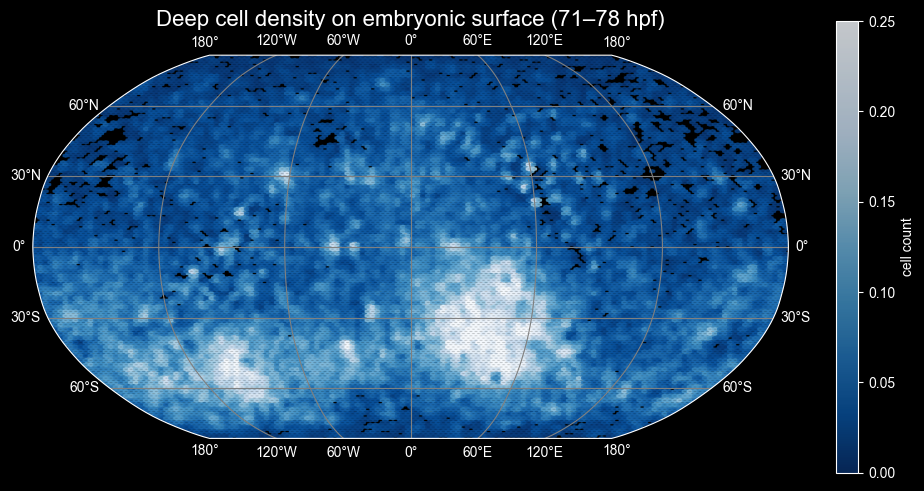

In [236]:
from scipy.spatial import cKDTree
import matplotlib as mpl
from cycler import cycler

mpl.rcParams.update({
    # --------  backgrounds  --------
    "figure.facecolor":  "black",
    "axes.facecolor":    "black",
    "savefig.facecolor": "black",
    "savefig.edgecolor": "black",

    # --------  text / lines  -------
    "text.color":        "white",
    "axes.edgecolor":    "white",
    "axes.labelcolor":   "white",
    "xtick.color":       "white",
    "ytick.color":       "white",
    "grid.color":        "0.5",

    # brighter default colour‑cycle so traces stay visible
    "axes.prop_cycle":   cycler(color=plt.cm.tab10.colors)
})

# proj = ccrs.Robinson()
nbins = 150
n_frames = t_max_a - t_min_a
# 1) Compute the initial hex‐bin
fig, ax = plt.subplots()
hb = ax.hexbin(
    x, y,
    gridsize=nbins,
    bins=None,    # raw counts
    mincnt=1,
    cmap='hot_r'
)
plt.close(fig)  # we’ll re‐plot after smoothing if desired

# 2) Extract raw counts and hex‐centers
counts = hb.get_array()        # shape (M,)
centers = hb.get_offsets()     # shape (M, 2): [x_center, y_center]


# 3) Build a KD‑tree on the hex‐centers
tree = cKDTree(centers)
stage_min = int(26 + t_min_a * 1.5 / 60)
stage_max = int(26 + t_max_a * 1.5 / 60)
# 4) For each hex‐center, find its k nearest neighbors (including itself)
k = 6  # change as needed
dists, idxs = tree.query(centers, k=k)

# 5) Compute the neighbor average for each bin
counts_smooth = (counts[idxs].mean(axis=1) / n_frames)
counts = counts / n_frames
# Optionally: re‐plot the smoothed hexbin
proj = ccrs.Robinson()
fig2  = plt.figure(figsize=(10,5))
ax2   = plt.axes(projection=proj)
hb2 = ax2.hexbin(
    centers[:,0], centers[:,1],
    C=counts_smooth,
    gridsize=nbins,
    reduce_C_function=np.mean,
    cmap="Blues_r",
    vmax=0.25,
    vmin=0,
    alpha=0.8,
    # transform=ccrs.PlateCarree()     # drop if coords already Robinson
)
fig2.colorbar(hb2, ax=ax2, label='cell count')
ax2.set_title(f"Deep cell density on embryonic surface ({stage_min}–{stage_max} hpf)", fontsize=16)
ax2.gridlines(draw_labels=True,
             xformatter=LongitudeFormatter(),
             yformatter=LatitudeFormatter())
plt.tight_layout()
plt.show()
fig.savefig(os.path.join(fig_path, "deep_cell_density.png"), dpi=300, bbox_inches='tight')

## Now overlay lcp trajectories

In [237]:
# 3) apply R to all points (shift first)
pts = lcp_df.loc[:, ["x","y","z"]].to_numpy() - sphere_center
pts_rot = (Rmat @ pts.T).T   # now “pole” is z

# 4) compute standard spherical coords
x, y, z = pts_rot[:,0], pts_rot[:,1], pts_rot[:,2]
r_lcp   = np.linalg.norm(pts_rot, axis=1)
theta_lcp = np.arccos(np.clip(z/r_lcp, -1, 1))   # 0…π
phi_lcp = np.arctan2(y, x)                 # –π…π
phi_lcp += phi_shift_manual
phi_wrapped_lcp = (phi_lcp + np.pi) % (2*np.pi) - np.pi
# deep_tracks_df[["r","theta","phi"]] = np.column_stack([r, theta, phi_wrapped])

In [238]:
lon_lcp = np.degrees(phi_lcp)                        # 0–360
lat_lcp = 90 - np.degrees(theta_lcp)                       # 90 at pole … -90

# ------------------------------------------------------------
# 2) Robinson projection with Cartopy
proj = ccrs.Robinson()

# ------------------------------------------------------------
# 3) Density with a 2‑D histogram (bins in projected coords)
#   project lon/lat → Robinson x,y (in metres):
xy = proj.transform_points(ccrs.PlateCarree(), lon_lcp, lat_lcp)
x_lcp, y_lcp = xy[:,0], xy[:,1]
lcp_df.loc[:, "x_proj"] = x_lcp
lcp_df.loc[:, "y_proj"] = y_lcp

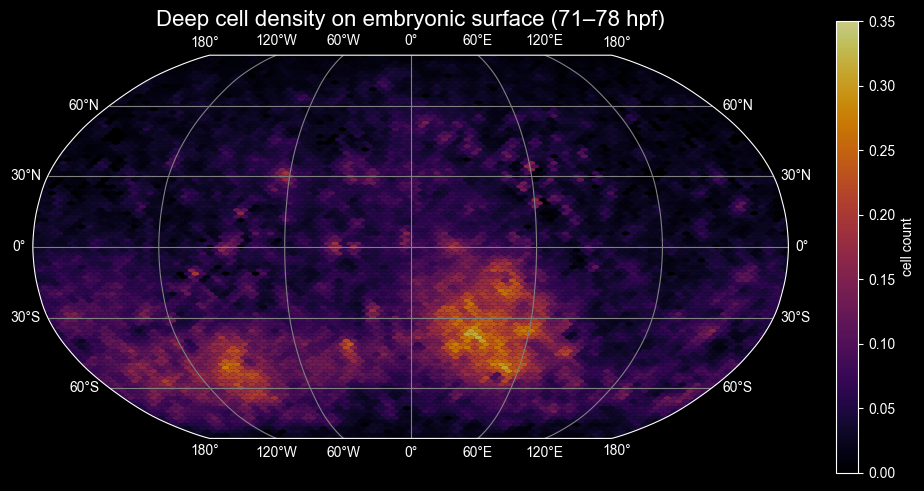

In [239]:
from matplotlib.collections import LineCollection
import matplotlib as mpl
import cartopy.crs as ccrs
nbins = 100
proj = ccrs.Robinson()
fig2  = plt.figure(figsize=(10, 5))
ax2   = plt.axes(projection=proj)

hb2 = ax2.hexbin(
        centers[:, 0], centers[:, 1],
        C=counts_smooth,
        gridsize=nbins,
        reduce_C_function=np.mean,
        cmap="inferno",
        vmin=0,
        vmax=0.35,
        alpha=0.8,
        linewidths=0,      # no stroke around each hex
        edgecolors="none"
        # transform=ccrs.PlateCarree()     # drop if coords already Robinson
)
fig2.colorbar(hb2, ax=ax2, label='cell count')

# ── 1.  add plain tracks  ──────────────────────────────────────────
# LINE_COLOUR = "crimson"    # pick any colour you like
#
# for trk_id, grp in lcp_df.groupby("track_id"):
#     # ensure the points are plotted in chronological order
#     grp_sorted = grp.sort_values("t")
#     ax2.plot(
#         grp_sorted["x_proj"], grp_sorted["y_proj"],
#         color=LINE_COLOUR,
#         linewidth=1.5,
#         # transform=ccrs.PlateCarree(),    # again, omit if already projected
#         zorder=3                         # puts lines on top of hexbin
#     )

# ── 2.  cosmetics  ─────────────────────────────────────────────────
ax2.set_title(f"Deep cell density on embryonic surface ({stage_min}–{stage_max} hpf)",
              fontsize=16)
# ax2.gridlines(draw_labels=True)
ax2.gridlines(draw_labels=True,
             xformatter=LongitudeFormatter(),
             yformatter=LatitudeFormatter())

plt.tight_layout()
plt.show()
fig2.savefig(os.path.join(fig_path, "deep_cell_density.png"), dpi=600, bbox_inches='tight')

C:\Users\nlammers\AppData\Local\Temp\ipykernel_34540\1516601990.py:26: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



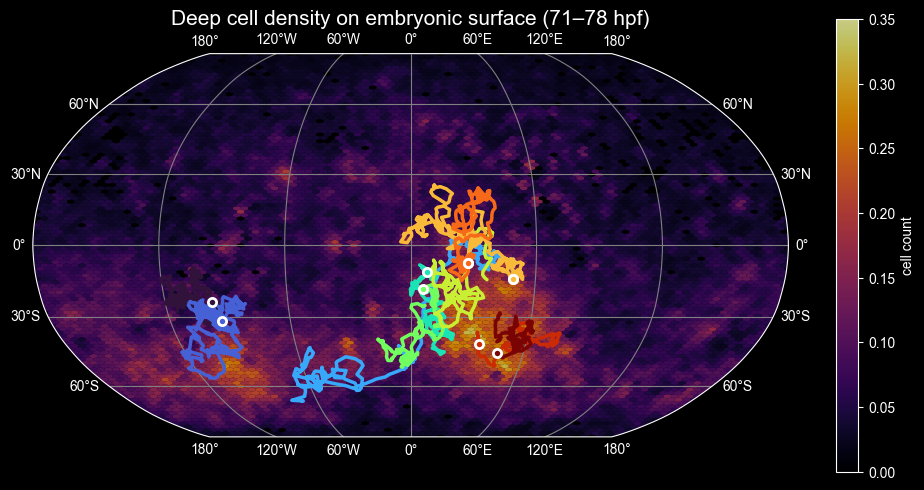

In [240]:
proj = ccrs.Robinson()
plt.close()
fig2  = plt.figure(figsize=(10, 5))
ax2   = plt.axes(projection=proj)

# ── 1. your hexbin (unchanged) ──────────────────────────────────────────────
hb2 = ax2.hexbin(
        centers[:, 0], centers[:, 1],
        C=counts_smooth+0.01,
        gridsize=nbins,
        reduce_C_function=np.mean,
        cmap="inferno",
        vmin=0,
        vmax=0.35,
        alpha=0.80,
        linewidths=0,      # no stroke around each hex
        edgecolors="none"
        # transform=ccrs.PlateCarree()    # remove if data are already Robinson
)
fig2.colorbar(hb2, ax=ax2, label='cell count')

# ── 2. coloured track lines  ────────────────────────────────────────────────
track_ids = np.sort(lcp_df['track_id'].unique())
n_tracks  = len(track_ids)

cmap  = mpl.cm.get_cmap('turbo')              # any perceptually‑uniform map
norm  = mpl.colors.Normalize(vmin=0, vmax=n_tracks-1)

# Map: track_id  →  rgba colour
track_colour = {tid: cmap(norm(i)) for i, tid in enumerate(track_ids)}

# ── 2.  plot each track in its own colour ───────────────────────────
for tid, grp in lcp_df.groupby('track_id'):
    xy = grp.sort_values('t')[['x_proj', 'y_proj']]     # ensure chronological order
    ax2.plot(
        xy['x_proj'], xy['y_proj'],
        color=track_colour[tid],
        linewidth=2.5,
        # transform=ccrs.PlateCarree(),         # drop if already projected
        zorder=3
    )

# ── 3.  (optional) add a colour‑bar keyed to track index ────────────
# sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
# cbar = fig2.colorbar(sm, ax=ax2, pad=0.02)
# cbar.set_label('track index (arbitrary order)')

# optional: overlay the individual points as a scatter
lcp_first = lcp_df.groupby("track_id").first().reset_index()
# ax2.scatter(
#     lcp_first['x_proj'], lcp_first['y_proj'],
#     c="white",
#     edgecolors="green",
#     s=15, zorder=4,
#     # transform=ccrs.PlateCarree()
# )
for tid, grp in lcp_df.groupby('track_id'):
    first_pt = grp.sort_values('t').iloc[0]        # or .iloc[-1] for last point
    ax2.scatter(
        first_pt['x_proj'], first_pt['y_proj'],
        edgecolors="white",                       # solid white interior
        facecolors=track_colour[tid],             # outline = track colour
        linewidths=2,
        s=35,
        zorder=4,
        # transform=proj                         # keep / drop per your CRS
    )

# ── 3. aesthetics & colour‑bar ──────────────────────────────────────────────
# cb = fig2.colorbar(sm, ax=ax2, pad=0.02, label='time (hpf)')
ax2.set_title(f"Deep cell density on embryonic surface ({stage_min}–{stage_max} hpf)",
              fontsize=15)

ax2.gridlines(draw_labels=True,
              xformatter=ccrs.cartopy.mpl.gridliner.LongitudeFormatter(),
              yformatter=ccrs.cartopy.mpl.gridliner.LatitudeFormatter())

plt.tight_layout()
plt.show()

fig2.savefig(os.path.join(fig_path, "deep_cell_density_lcp_tracks.png"), dpi=300, bbox_inches='tight', facecolor="black")

In [241]:
for tid, grp in lcp_df.groupby('track_id'):
    first_pt = grp.sort_values('t').iloc[0]
    print(first_pt['y_proj'])

-2541023.76726915
-3429502.1477001235
-1514814.9153110099
-1194272.711335372
-1949056.476893788
-811923.4308335378
-1514814.9153110099
-811923.4308335378
-4431259.409283001
-4851853.737626519


In [242]:
np.min(centers, axis=0)

array([-16999531.2752666,  -8615416.9222647])